In [1]:
import numpy as np
import sklearn
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.manifold import TSNE
from mpl_toolkits.mplot3d import Axes3D
from scipy import stats
from PIL import Image
import scipy.stats
from tabulate import tabulate

In [2]:
path_to_file = '/Users/mac/Desktop/Workshop1/water_potability.csv'
source_df = pd.read_csv(path_to_file, engine='python')
Data = source_df.copy()
source_df.head(5)

,ph,Hardness,Solids,Chloramines,Sulfate,Conductivity,Organic_carbon,Trihalomethanes,Turbidity,Potability
0,NaN,204.890455,20791.318981,7.300212,368.516441,564.308654,10.379783,86.990970,2.963135,0
1,3.716080,129.422921,18630.057858,6.635246,NaN,592.885359,15.180013,56.329076,4.500656,0
2,8.099124,224.236259,19909.541732,9.275884,NaN,418.606213,16.868637,66.420093,3.055934,0
3,8.316766,214.373394,22018.417441,8.059332,356.886136,363.266516,18.436524,100.341674,4.628771,0
4,9.092223,181.101509,17978.986339,6.546600,310.135738,398.410813,11.558279,31.997993,4.075075,0


In [3]:
mu=np.array([1,10,20])
sigma=np.matrix([[4,10,0],[10,25,0],[0,0,100]])
data=np.random.multivariate_normal(mu,sigma,1000)
y_class = source_df[["Potability"]]
source_df.fillna(source_df['ph'].median(),inplace=True)
conditional_data = source_df.copy()
source_df.drop(columns="Potability",inplace = True)
source_df.isnull().sum()

ph                 0
Hardness           0
Solids             0
Chloramines        0
Sulfate            0
Conductivity       0
Organic_carbon     0
Trihalomethanes    0
Turbidity          0
dtype: int64

/Users/mac/opt/anaconda3/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


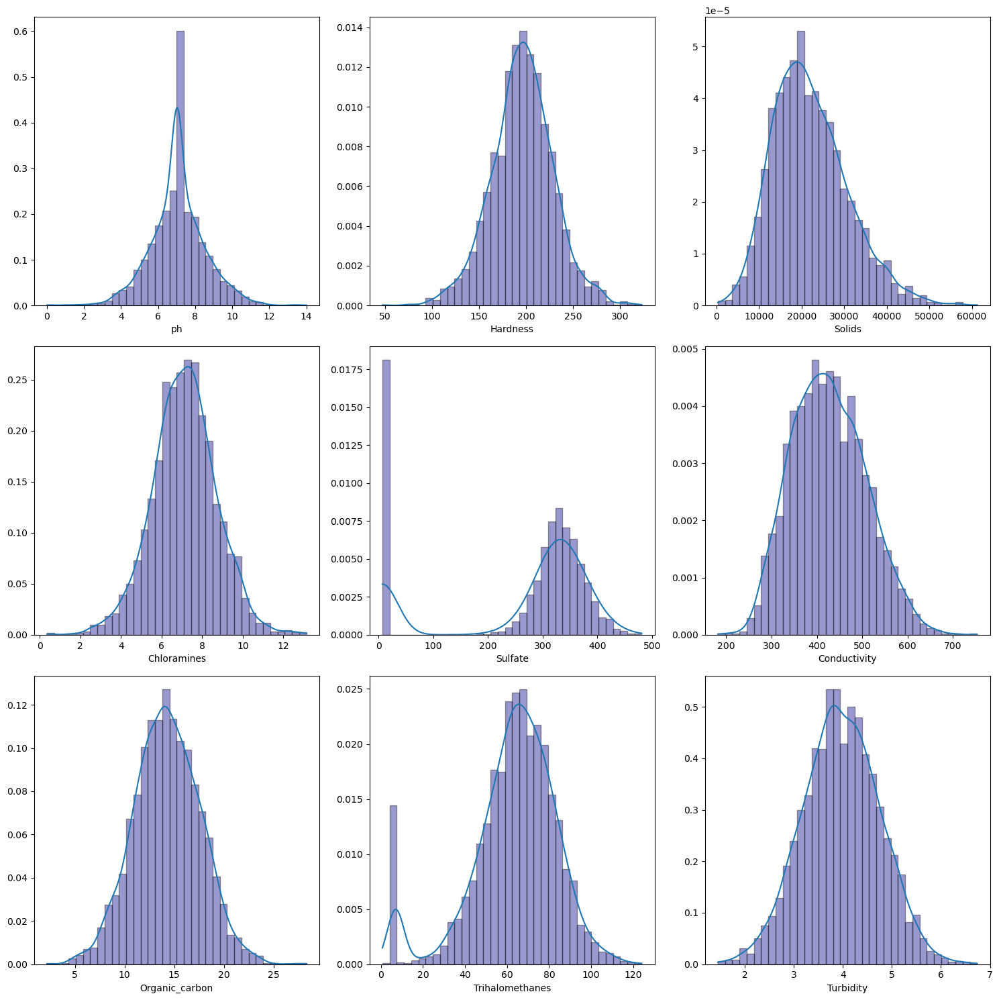

In [4]:
features = source_df
j=1
plt.figure(figsize = (15,15))
for i in features.columns:
    kernel = scipy.stats.gaussian_kde(features[i])
    min_amount, max_amount = features[i].min(), features[i].max()
    x = np.linspace(min_amount, max_amount, len(features[i]))
    kde_values = kernel(x)
    
    plt.subplot(3,3,j)
    sns.distplot(features[i], norm_hist=True, kde=False, 
             bins=int(180/5), color = 'darkblue', 
             hist_kws={'edgecolor':'black'},
             kde_kws={'linewidth': 4})
    plt.plot(x, kde_values)
    j=j+1

plt.tight_layout()

In [5]:
Data = pd.DataFrame(Data)
sns.pairplot(data = Data,hue = 'Potability',palette=['teal','coral'],kind='reg', size=10, aspect=0.8 )

/Users/mac/opt/anaconda3/lib/python3.9/site-packages/seaborn/axisgrid.py:2076: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


In [6]:
features[features.columns[:]].mean()

ph                     7.074194
Hardness             196.369496
Solids             22014.092526
Chloramines            7.122277
Sulfate              255.881034
Conductivity         426.205111
Organic_carbon        14.284970
Trihalomethanes       63.460931
Turbidity              3.966786
dtype: float64

In [7]:
features[features.columns[:]].var()

ph                 2.161018e+00
Hardness           1.081079e+03
Solids             7.688783e+07
Chloramines        2.506158e+00
Sulfate            2.069587e+04
Conductivity       6.532529e+03
Organic_carbon     1.094394e+01
Trihalomethanes    4.143651e+02
Turbidity          6.089967e-01
dtype: float64

In [8]:
features[features.columns].cov()

,ph,Hardness,Solids,Chloramines,Sulfate,Conductivity,Organic_carbon,Trihalomethanes,Turbidity
ph,2.161018,3.661841,-1.057046e+03,-0.073867,1.369361,2.075182,0.195693,0.043197,-0.041422
Hardness,3.661841,1081.078715,-1.352149e+04,-1.564367,-149.072989,-63.552473,0.392670,-4.269781,-0.370747
Solids,-1057.046172,-13521.486526,7.688783e+07,-973.746052,-34600.947065,9802.117116,297.108377,-3991.077148,133.751106
Chloramines,-0.073867,-1.564367,-9.737461e+02,2.506158,0.600221,-2.621264,-0.066268,0.496545,0.002920
Sulfate,1.369361,-149.072989,-3.460095e+04,0.600221,20695.868448,-209.221666,14.007549,-36.446474,0.021521
Conductivity,2.075182,-63.552473,9.802117e+03,-2.621264,-209.221666,6532.529330,5.605967,25.348144,0.365712
Organic_carbon,0.195693,0.392670,2.971084e+02,-0.066268,14.007549,5.605967,10.943936,-0.916802,-0.070499
Trihalomethanes,0.043197,-4.269781,-3.991077e+03,0.496545,-36.446474,25.348144,-0.916802,414.365114,-0.312091
Turbidity,-0.041422,-0.370747,1.337511e+02,0.002920,0.021521,0.365712,-0.070499,-0.312091,0.608997


In [9]:

column=Data['Potability']
Potability= np.unique (column)
Potability

array([0, 1])

In [10]:
features.columns

Index(['ph', 'Hardness', 'Solids', 'Chloramines', 'Sulfate', 'Conductivity',
       'Organic_carbon', 'Trihalomethanes', 'Turbidity'],
      dtype='object')

In [11]:
conditional_mean=[]
conditional_var=[] 
for i in Potability:
    means=Data[Data.Potability==i].mean()
    
    conditional_mean.append([mean for mean in means[:]])
    variances=Data[Data.Potability==i].var(ddof=0) 
    conditional_var.append([variance for variance in variances[:]])
rowIDs=['0','1']
print("Conditional mean")
print(tabulate(conditional_mean, headers=['ph', 'Hardness', 'Solids', 'Chloramines', 'Sulfate', 'Conductivity',
       'Organic_carbon', 'Trihalomethanes', 'Turbidity'],tablefmt='fancy_grid',numalign ='center',showindex=rowIDs))
print()
print("Conditional variance")
print(tabulate(conditional_var, headers=['ph', 'Hardness', 'Solids', 'Chloramines', 'Sulfate', 'Conductivity',
       'Organic_carbon', 'Trihalomethanes', 'Turbidity'], tablefmt='fancy_grid',numalign ='center',showindex=rowIDs))



Conditional mean
╒════╤═════════╤═════════╤════════════╤══════════╤═══════════════╤═══════════╤════════════════╤══════════════════╤═══════════════════╤═════════════╕
│    │         │   ph    │  Hardness  │  Solids  │  Chloramines  │  Sulfate  │  Conductivity  │  Organic_carbon  │  Trihalomethanes  │  Turbidity  │
╞════╪═════════╪═════════╪════════════╪══════════╪═══════════════╪═══════════╪════════════════╪══════════════════╪═══════════════════╪═════════════╡
│ 0  │ 7.08538 │ 196.733 │  21777.5   │ 7.09217  │    334.564    │  426.73   │    14.3643     │     66.3036      │      3.9658       │      0      │
├────┼─────────┼─────────┼────────────┼──────────┼───────────────┼───────────┼────────────────┼──────────────────┼───────────────────┼─────────────┤
│ 1  │ 7.07378 │ 195.801 │   22384    │ 7.16934  │    332.567    │  425.384  │    14.1609     │     66.5397      │      3.96833      │      1      │
╘════╧═════════╧═════════╧════════════╧══════════╧═══════════════╧═══════════╧═══════════

/Users/mac/opt/anaconda3/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


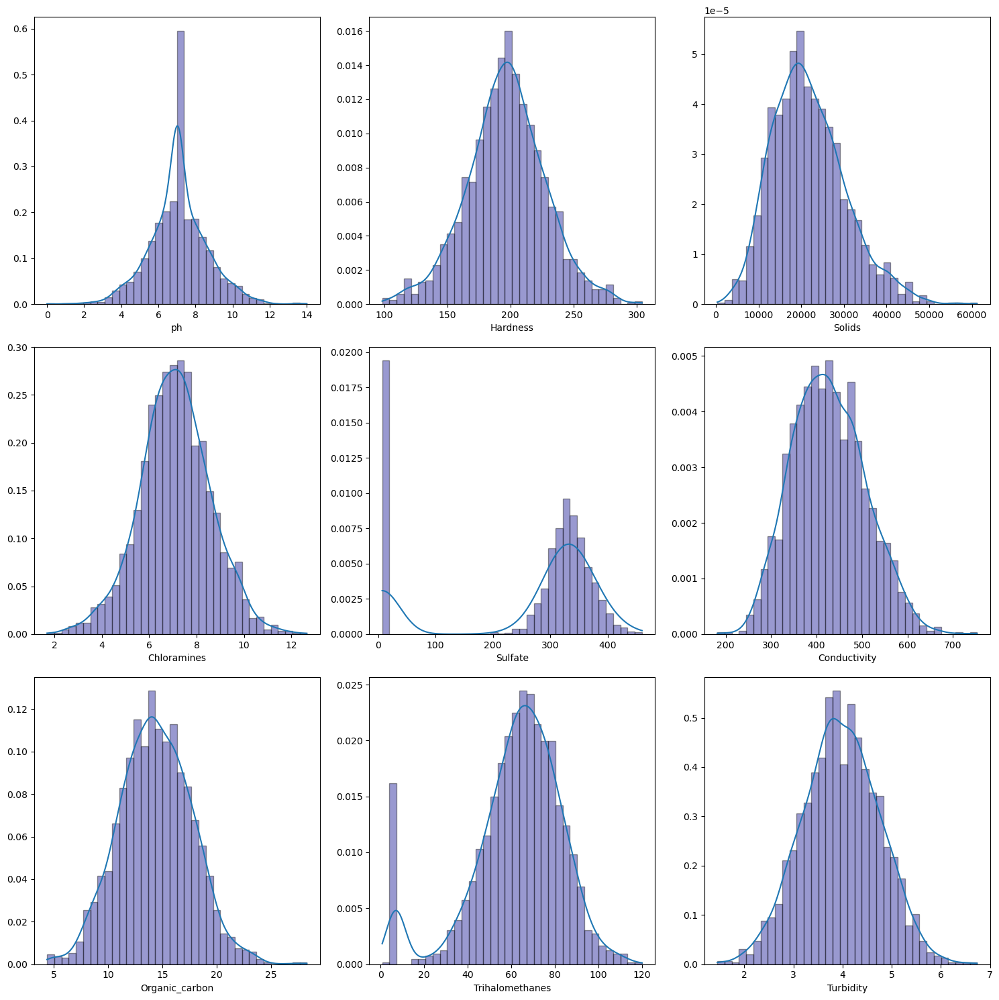

In [12]:

sample_0 = conditional_data[conditional_data.Potability==0]
j=1
plt.figure(figsize = (15,15))
for i in sample_0.columns[:-1]:
    kernel = scipy.stats.gaussian_kde(sample_0[i])
    min_amount, max_amount = sample_0[i].min(), sample_0[i].max()
    x = np.linspace(min_amount, max_amount, len(sample_0[i]))
    kde_values = kernel(x)
    
    plt.subplot(3,3,j)
    sns.distplot(sample_0[i], norm_hist=True, kde=False, 
             bins=int(180/5), color = 'darkblue', 
             hist_kws={'edgecolor':'black'},
             kde_kws={'linewidth': 4})
    plt.plot(x, kde_values)
    j=j+1

plt.tight_layout()

In [13]:
Data[Data.Potability==0].mean()[:]

ph                     7.085378
Hardness             196.733292
Solids             21777.490788
Chloramines            7.092175
Sulfate              334.564290
Conductivity         426.730454
Organic_carbon        14.364335
Trihalomethanes       66.303555
Turbidity              3.965800
Potability             0.000000
dtype: float64

In [14]:
Data[Data.Potability==0].var()[:]

ph                 2.834169e+00
Hardness           9.645708e+02
Solids             7.298402e+07
Chloramines        2.253136e+00
Sulfate            1.350235e+03
Conductivity       6.407573e+03
Organic_carbon     1.111925e+01
Trihalomethanes    2.585445e+02
Turbidity          6.088406e-01
Potability         0.000000e+00
dtype: float64

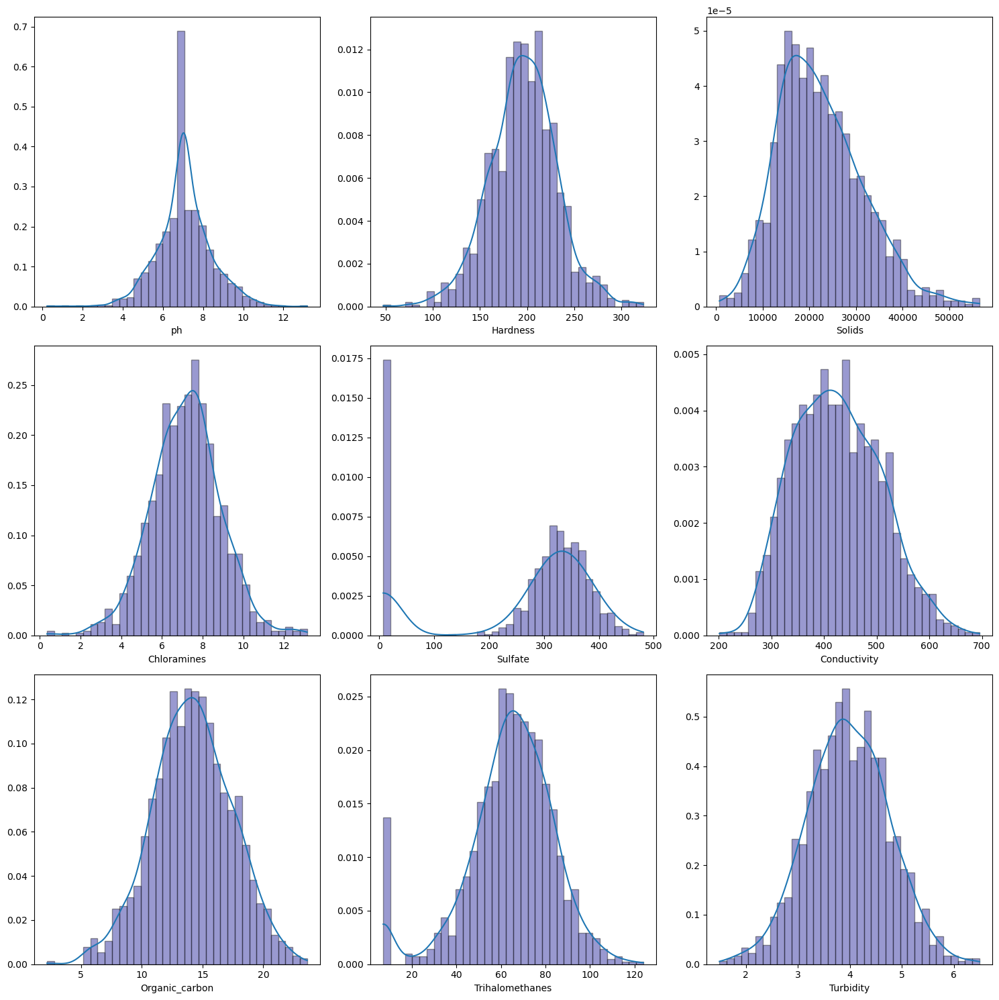

In [15]:
sample_1 = conditional_data[conditional_data.Potability==1]
j=1
plt.figure(figsize = (15,15))
for i in sample_1.columns[:-1]:
    kernel = scipy.stats.gaussian_kde(sample_1[i])
    min_amount, max_amount = sample_1[i].min(), sample_1[i].max()
    x = np.linspace(min_amount, max_amount, len(sample_1[i]))
    kde_values = kernel(x)
    
    plt.subplot(3,3,j)
    sns.distplot(sample_1[i], norm_hist=True, kde=False, 
             bins=int(180/5), color = 'darkblue', 
             hist_kws={'edgecolor':'black'},
             kde_kws={'linewidth': 4})
    plt.plot(x, kde_values)
    j=j+1

plt.tight_layout()

In [16]:
Data[Data.Potability==1].mean()[:]

ph                     7.073783
Hardness             195.800744
Solids             22383.991018
Chloramines            7.169338
Sulfate              332.566990
Conductivity         425.383800
Organic_carbon        14.160893
Trihalomethanes       66.539684
Turbidity              3.968328
Potability             1.000000
dtype: float64

In [17]:
Data[Data.Potability==1].var()[:]

ph                 2.096843e+00
Hardness           1.263592e+03
Solids             8.282839e+07
Chloramines        2.900167e+00
Sulfate            2.274605e+03
Conductivity       6.731948e+03
Organic_carbon     1.065309e+01
Trihalomethanes    2.665846e+02
Turbidity          6.097139e-01
Potability         0.000000e+00
dtype: float64

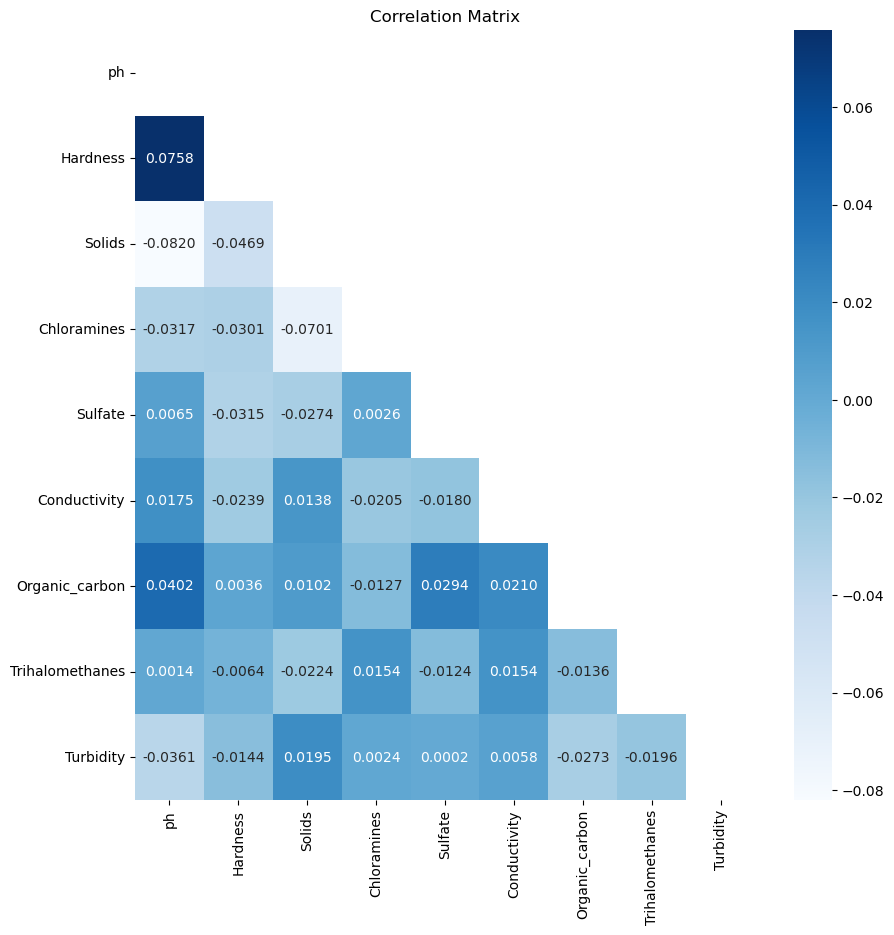

In [40]:
#Pair correlation coefficients, Correlation Matrix
fig, ax = plt.subplots(figsize=(10,10))
corr = conditional_data[conditional_data.columns[:-1]].corr()
mask = np.zeros_like(corr, dtype=bool)
mask[np.triu_indices_from(mask)] = True
sns.heatmap(corr, mask=mask, annot=True,  fmt='.4f',ax=ax, cmap = 'Blues')
plt.title('Correlation Matrix')
plt.show()

In [19]:
results=[]
columns_names=conditional_data.columns[:-1]
i=0
for col_name in columns_names:
    for col_name_2 in columns_names[i:]:
        if(col_name!=col_name_2):
            x=conditional_data[col_name].apply(lambda x: float(x))
            y=conditional_data[col_name_2].apply(lambda x: float(x))
            r, p = stats.pearsonr(x,y)
            r_z = np.arctanh(r) # matches Fisher transform
            # Corresponding standard deviation
            se = 1/np.sqrt(x.size-3)
            alpha = 0.05
            z = stats.norm.ppf(1-alpha/2)
            lo_z, hi_z = np.tanh(r_z-z*se), np.tanh(r_z+z*se)
            results.append([col_name,col_name_2,r,[lo_z,hi_z],p])
    i+=1
#cor_coe = Correlation Coefficient , con_int = Confidence Interval , sig_le = P: Significance Level
print(tabulate(results, headers=['First Col','Second Col','cor_coe','con_int','sig_le'],tablefmt='fancy_grid',numalign ='center'))


╒═════════════════╤═════════════════╤═════════════╤════════════════════════════════════════════════╤═════════════╕
│ First Col       │ Second Col      │   cor_coe   │ con_int                                        │   sig_le    │
╞═════════════════╪═════════════════╪═════════════╪════════════════════════════════════════════════╪═════════════╡
│ ph              │ Hardness        │  0.0757603  │ [0.04162265568310772, 0.10972127053187135]     │ 1.41947e-05 │
├─────────────────┼─────────────────┼─────────────┼────────────────────────────────────────────────┼─────────────┤
│ ph              │ Solids          │ -0.0820042  │ [-0.11592426376169696, -0.04789303889195404]   │ 2.60486e-06 │
├─────────────────┼─────────────────┼─────────────┼────────────────────────────────────────────────┼─────────────┤
│ ph              │ Chloramines     │ -0.0317407  │ [-0.06591468879227431, 0.0025076595694773552]  │  0.0692958  │
├─────────────────┼─────────────────┼─────────────┼─────────────────────────────

In [20]:
from sklearn.model_selection import train_test_split

dataTargetOrg = conditional_data[['Turbidity']]
dataPredOrg = conditional_data.drop('Turbidity',axis=1)
dataPredOrg = dataPredOrg.drop('Potability',axis=1)
# Data splitting
x_trainOrg, x_testOrg, y_trainOrg, y_testOrg = train_test_split(dataPredOrg, dataTargetOrg, test_size=0.2, random_state=0)

In [21]:
scaler = StandardScaler()
x_train_scaler = pd.DataFrame(scaler.fit_transform(x_trainOrg))
y_train_scaler = pd.DataFrame(scaler.fit_transform(y_trainOrg))
x_test_scaler = pd.DataFrame(scaler.fit_transform(x_testOrg))
y_test_scaler = pd.DataFrame(scaler.fit_transform(y_testOrg))

In [22]:
i = 0
for col_name in x_trainOrg:
    x=conditional_data[col_name].apply(lambda x: float(x))
    y=conditional_data['Turbidity'].apply(lambda x: float(x))
    r, p = stats.pearsonr(x,y)
    r_z = np.arctanh(r) # matches Fisher transform
    # Corresponding standard deviation
    se = 1/np.sqrt(x.size-3)
    alpha = 0.05
    z = stats.norm.ppf(1-alpha/2)
    lo_z, hi_z = np.tanh(r_z-z*se), np.tanh(r_z+z*se)
    print('Correlation for {} and Turbidity: {}, p_value: {}, confidence intervals: ({}, {})'.format(col_name,r,p,lo_z,hi_z))
    print()
    

Correlation for ph and Turbidity: -0.036106998209464794, p_value: 0.03877959602543321, confidence intervals: (-0.07026574939464834, -0.0018636673647552426)

Correlation for Hardness and Turbidity: -0.014449129313291526, p_value: 0.40838274697309124, confidence intervals: (-0.048670681388204226, 0.019806306518250046)

Correlation for Solids and Turbidity: 0.019546144182463678, p_value: 0.26338343826463706, confidence intervals: (-0.014709337090964314, 0.05375579694057681)

Correlation for Chloramines and Turbidity: 0.0023633210684490136, p_value: 0.8924407466026629, confidence intervals: (-0.0318848947681162, 0.03660599370239301)

Correlation for Sulfate and Turbidity: 0.00019169342921354984, p_value: 0.9912492603967936, confidence intervals: (-0.03405416540753794, 0.034437102643853836)

Correlation for Conductivity and Turbidity: 0.005798167748576351, p_value: 0.7400840011516184, confidence intervals: (-0.0284531172401486, 0.04003585343455079)

Correlation for Organic_carbon and Turbid

In [23]:
i = 0
for col_name in x_trainOrg:
    x=conditional_data[col_name].apply(lambda x: float(x))
    y=conditional_data['Potability'].apply(lambda x: float(x))
    r, p = stats.pearsonr(x,y)
    r_z = np.arctanh(r) # matches Fisher transform
    # Corresponding standard deviation
    se = 1/np.sqrt(x.size-3)
    alpha = 0.05
    z = stats.norm.ppf(1-alpha/2)
    lo_z, hi_z = np.tanh(r_z-z*se), np.tanh(r_z+z*se)
    print('Correlation for {} and Potability: {}, p_value: {}, confidence intervals: ({}, {})'.format(col_name,r,p,lo_z,hi_z))
    print()

Correlation for ph and Potability: -0.0030139288807439733, p_value: 0.8630909574191309, confidence intervals: (-0.03725571885498312, 0.031234930281137375)

Correlation for Hardness and Potability: -0.013836558085111377, p_value: 0.4285415874064298, confidence intervals: (-0.048059420809031826, 0.02041875245433045)

Correlation for Solids and Potability: 0.033743313393649804, p_value: 0.053463638184233594, confidence intervals: (-0.0005029030241970715, 0.06791047396723086)

Correlation for Chloramines and Potability: 0.023778971994669513, p_value: 0.1736102246498992, confidence intervals: (-0.010475193510408291, 0.057977394777178275)

Correlation for Sulfate and Potability: 0.011417567562040688, p_value: 0.5135810604251734, confidence intervals: (-0.022836997028772673, 0.04564535542604066)

Correlation for Conductivity and Potability: -0.008128319721545431, p_value: 0.6418845485941129, confidence intervals: (-0.04236216309478917, 0.02612458758750137)

Correlation for Organic_carbon and 

In [24]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
def applyVIF(X):
   vif = pd.DataFrame()
   vif["Features"] = X.columns
   vif["VIF"] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]
   print(vif)
# before preprocessing
print("before preprocessing")
print(applyVIF(x_trainOrg))
print("after preprocessing")
print(applyVIF(x_train_scaler))

before preprocessing
          Features        VIF
0               ph  21.510739
1         Hardness  28.097654
2           Solids   6.839244
3      Chloramines  17.148191
4          Sulfate   4.029669
5     Conductivity  23.605374
6   Organic_carbon  17.294498
7  Trihalomethanes  10.016614
None
after preprocessing
   Features       VIF
0         0  1.016543
1         1  1.011800
2         2  1.019080
3         3  1.009501
4         4  1.004407
5         5  1.004259
6         6  1.002368
7         7  1.002867
None


In [25]:
# Defining Mean Absolute Precentage Error Function
def mean_absolute_percentage_error(y_true, y_pred): 
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

model parameters:
model weights: [[-2.29306481e-02 -5.59022073e-04  1.53887853e-06  2.17769925e-03
   2.91695277e-05  7.85963615e-05 -8.96669061e-03 -1.31939896e-03]]
model bias: [4.36798461]
MAE: 0.6519238685705
MSE 0.6427280009326377
MAPE 0.1832544026111864
Determination coefficient =  -0.013861511171220586


Text(0, 0.5, 'Turbidity')

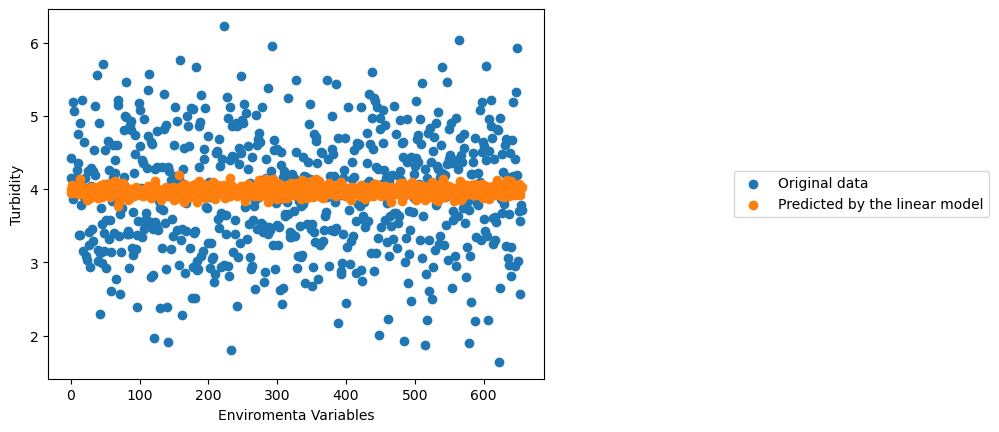

In [26]:
from sklearn.linear_model import LinearRegression, LinearRegression, Ridge, Lasso
from sklearn.metrics import mean_absolute_error, mean_squared_error, mean_absolute_percentage_error


lr = LinearRegression()
lr.fit(x_trainOrg, y_trainOrg)

y_pred_linear = lr.predict(x_testOrg)

params = np.append(lr.intercept_, lr.coef_)
print('model parameters:')
print('model weights:', lr.coef_)
print('model bias:', lr.intercept_)

mae = mean_absolute_error(y_testOrg, y_pred_linear)
mse = mean_squared_error(y_testOrg, y_pred_linear)
mape = mean_absolute_percentage_error(y_testOrg, y_pred_linear)
print('MAE:', mae)
print('MSE',mse)
print('MAPE',mape)

print('Determination coefficient = ', lr.score(x_testOrg, y_testOrg))

x = []
for i in range(len(y_testOrg)):
    x.append(i)
plt.scatter(x, y_testOrg, label = 'Original data')
plt.scatter(x, y_pred_linear, label = 'Predicted by the linear model')
plt.legend(loc="center right",borderaxespad=0.1, bbox_to_anchor=(1.9, 0.5))
plt.xlabel('Enviromenta Variables')
plt.ylabel('Turbidity')

In [27]:
def lassos (alphas,x_train_scaler, y_train_scaler,y_test_scaler):
    results=[]
    pred=[]
    lassos=[]
    i=0
    for alpha in alphas:
        lasso = Lasso(alpha=alpha)
        # Fitting Data
        lasso.fit(x_train_scaler, y_train_scaler)
        # Forecast on a test sample
        y_pred_scaler = np.expand_dims(lasso.predict(x_test_scaler), 1)      
        # Errors
        mae=(mean_absolute_error(y_test_scaler, y_pred_scaler))
        mse=(mean_squared_error(y_test_scaler, y_pred_scaler))
        mape=(mean_absolute_percentage_error(y_test_scaler, y_pred_scaler))
        cofficient=( lasso.score(x_test_scaler, y_test_scaler))
        intercept=(lasso.intercept_)
        coef=(lasso.coef_)
        pred.append(y_pred_scaler)
        results.append([alpha,mae,mse,mape,cofficient,intercept,coef])  
        lassos.append(lasso)      
    return results, pred,lassos

In [28]:
alphas=[1  , 0.3, 0.04 ,0.005, 0.006  , 0.008,0.009 , 0.0001, 0.00001]
results, pred,lassos_all =  lassos(alphas,x_train_scaler,y_train_scaler,y_test_scaler)
print(tabulate(results, headers=[ 'Alpha','MAE','MSE','MAPE ','Cofficient ','Bias','Weights '],  tablefmt='fancy_grid',numalign ='center'))

╒═════════╤══════════╤═════════╤═════════╤═══════════════╤══════════════╤══════════════════════════════════════════════════════════════════════════╕
│  Alpha  │   MAE    │   MSE   │  MAPE   │  Cofficient   │     Bias     │ Weights                                                                  │
╞═════════╪══════════╪═════════╪═════════╪═══════════════╪══════════════╪══════════════════════════════════════════════════════════════════════════╡
│    1    │ 0.815234 │    1    │    1    │       0       │ -1.41024e-16 │ [-0. -0.  0.  0.  0.  0. -0. -0.]                                        │
├─────────┼──────────┼─────────┼─────────┼───────────────┼──────────────┼──────────────────────────────────────────────────────────────────────────┤
│   0.3   │ 0.815234 │    1    │    1    │       0       │ -1.41024e-16 │ [-0. -0.  0.  0.  0.  0. -0. -0.]                                        │
├─────────┼──────────┼─────────┼─────────┼───────────────┼──────────────┼─────────────────────────────────

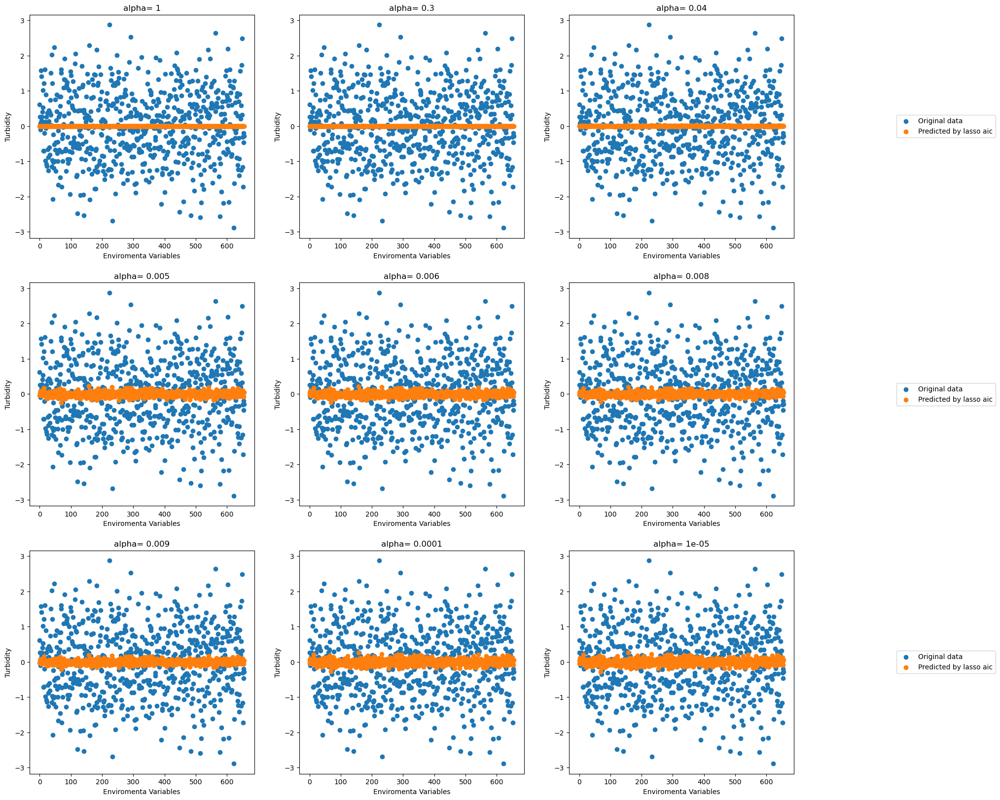

In [29]:
fig = plt.figure(figsize=(20, 20))
x = []
for i in range(len(y_test_scaler)):
    x.append(i)
for j in range (len(pred)):
    subplot = 331 + j
    ax = fig.add_subplot(subplot)
    plt.scatter(x, y_test_scaler, label = 'Original data')
    plt.scatter(x, pred[j], label = 'Predicted by lasso aic')
    plt.legend(loc="center right",borderaxespad=0.1, bbox_to_anchor=(1.9, 0.5))
    plt.xlabel('Enviromenta Variables')
    plt.ylabel('Turbidity')
    plt.title ('alpha= ' + str(alphas[j]))

In [30]:
def ridge_method (alphas,x_train_scaler, y_train_scaler,y_test_scaler):
    results=[]
    pred=[]
    ridges=[]
    i=0
    for alpha in alphas:
        # Create a lasso regression model
        ridge = Ridge(alpha)
        # Fitting Data
        ridge.fit(x_train_scaler, y_train_scaler)
        # Forecast on a test sample
        y_pred_scaler = ridge.predict(x_test_scaler)   
        # Errors
        mae=(mean_absolute_error(y_test_scaler, y_pred_scaler))
        mse=(mean_squared_error(y_test_scaler, y_pred_scaler))
        mape=(mean_absolute_percentage_error(y_test_scaler, y_pred_scaler))
        cofficient=(ridge.score(x_test_scaler, y_test_scaler))
        intercept=(ridge.intercept_)
        coef=(ridge.coef_)
        pred.append(y_pred_scaler)
        results.append([alpha,mae,mse,mape,cofficient,intercept,coef])  
        ridges.append(ridge)      
    return results, pred,ridges

In [31]:
alphas=[0.1, 10 , 500 , 1000, 10000 , 80000, 100000,  200000, 1000000 ]
results_ridg, pred_ridg,ridges_all =  ridge_method(alphas,x_train_scaler,y_train_scaler,y_test_scaler)
print(tabulate(results_ridg, headers=[ 'Alpha','MAE','MSE','MAPE ','Cofficient ','Bias','Weights '],  tablefmt='fancy_grid',numalign ='center'))


╒═════════╤══════════╤═════════╤═════════╤═══════════════╤══════════════╤═══════════════════════════════════════════════════════════════════════════╕
│  Alpha  │   MAE    │   MSE   │  MAPE   │  Cofficient   │     Bias     │ Weights                                                                   │
╞═════════╪══════════╪═════════╪═════════╪═══════════════╪══════════════╪═══════════════════════════════════════════════════════════════════════════╡
│   0.1   │ 0.818453 │ 1.01198 │ 1.16854 │  -0.0119816   │ -1.26865e-16 │ [[-0.04320851 -0.02353128  0.01732677  0.00452226  0.00540817  0.00818954 │
│         │          │         │         │               │              │   -0.03844917 -0.03471131]]                                               │
├─────────┼──────────┼─────────┼─────────┼───────────────┼──────────────┼───────────────────────────────────────────────────────────────────────────┤
│   10    │ 0.818428 │ 1.01192 │ 1.16781 │  -0.0119167   │ -1.26917e-16 │ [[-0.04306036 -0.02345713 

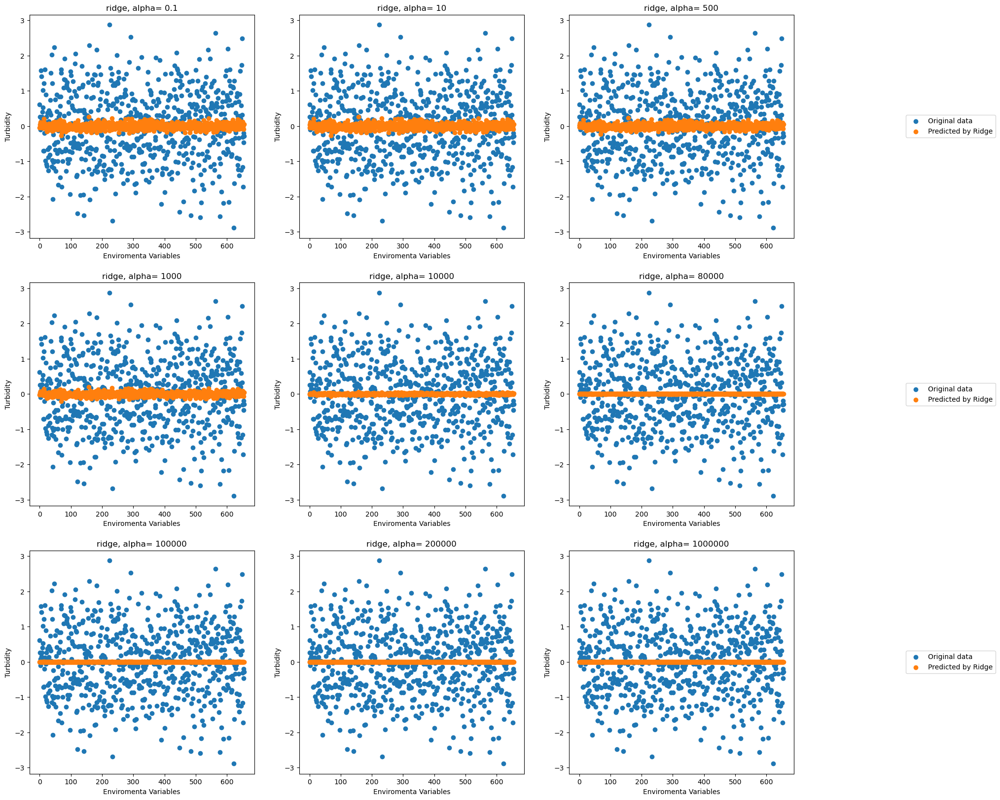

In [32]:
fig = plt.figure(figsize=(20, 20))
x = []
for i in range(len(y_test_scaler)):
    x.append(i)
for j in range (len(pred_ridg)):
    subplot = 331 + j
    ax = fig.add_subplot(subplot)
    plt.scatter(x, y_test_scaler, label = 'Original data')
    plt.scatter(x, pred_ridg[j], label = 'Predicted by Ridge')
    plt.legend(loc="center right",borderaxespad=0.1, bbox_to_anchor=(1.9, 0.5))
    plt.xlabel('Enviromenta Variables')
    plt.ylabel('Turbidity')
    plt.title ('ridge, alpha= ' + str(alphas[j]))

/Users/mac/opt/anaconda3/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but Ridge was fitted without feature names
  warnings.warn(
/Users/mac/opt/anaconda3/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but Ridge was fitted without feature names
  warnings.warn(
/Users/mac/opt/anaconda3/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but Ridge was fitted without feature names
  warnings.warn(
/Users/mac/opt/anaconda3/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but Ridge was fitted without feature names
  warnings.warn(
/Users/mac/opt/anaconda3/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but Ridge was fitted without feature names
  warnings.warn(
/Users/mac/opt/anaconda3/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but Ridge was fitted without feature names
  warning

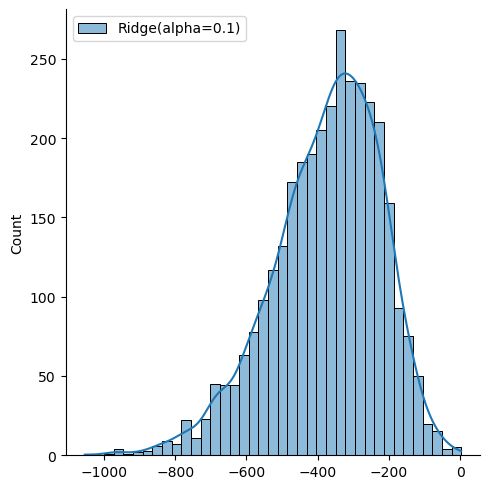

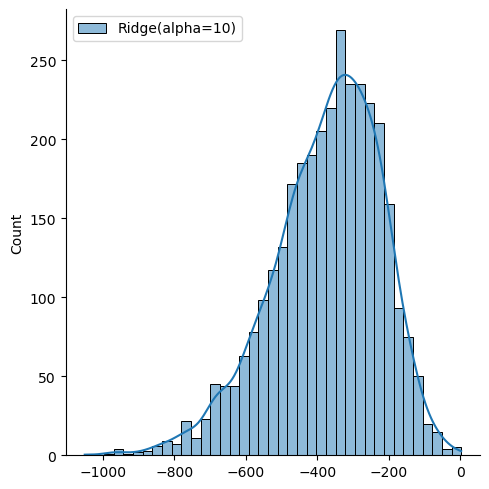

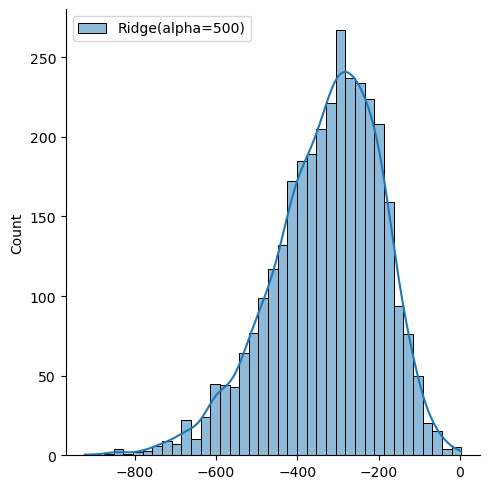

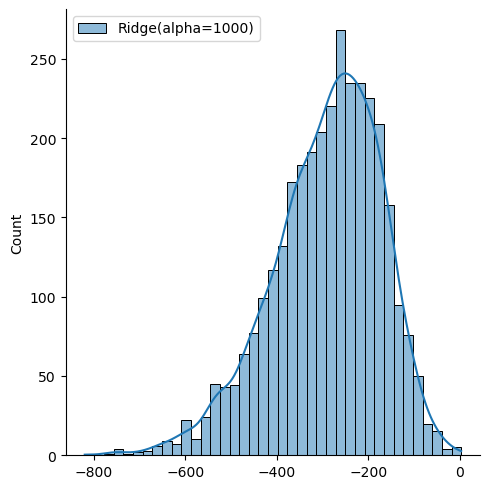

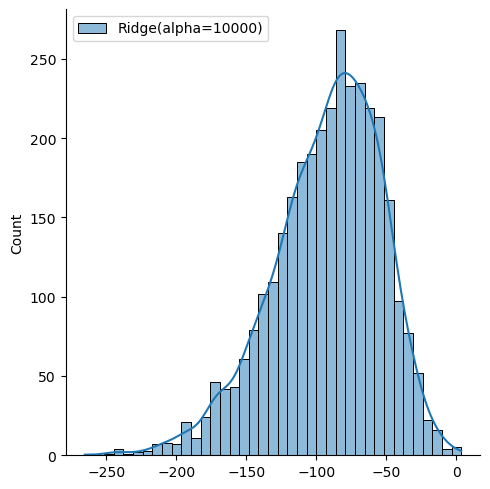

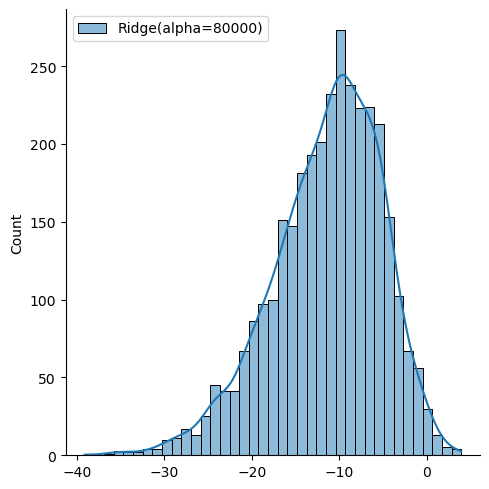

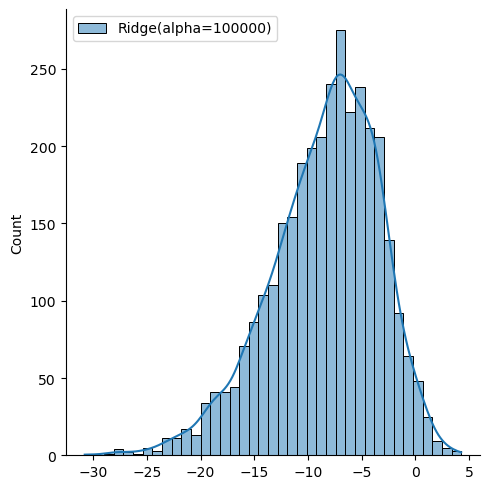

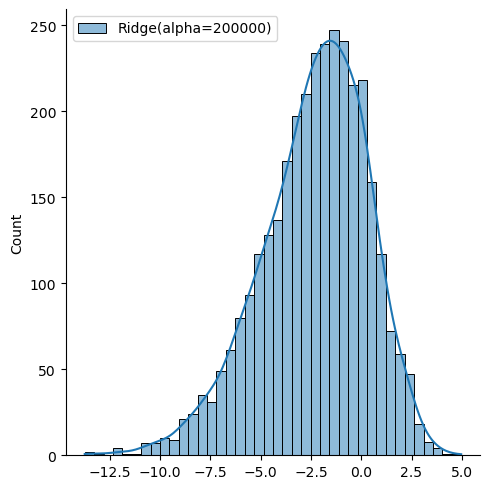

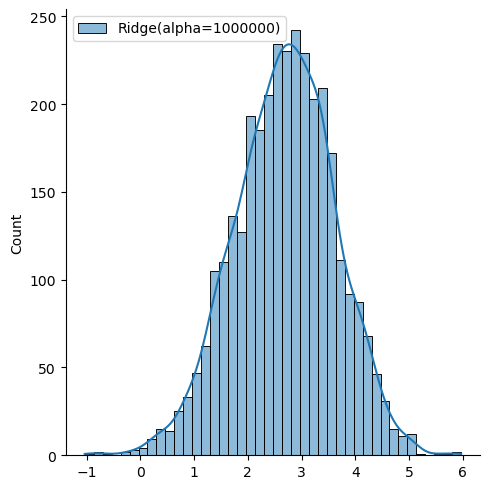

In [33]:

for i in range(len(ridges_all)):

    y_pred_all = ridges_all[i].predict(dataPredOrg)
    # distribution of residuals
    target = np.array(dataTargetOrg)
    predicts = np.array(y_pred_all)
    diff = target[:,0] - predicts[:,0]   
    sns.displot(diff, kde=True,label=ridges_all[i])
    plt.legend()
  


In [34]:
from statsmodels.graphics.gofplots import qqplot
from scipy.stats import norm, uniform
def test_risduals (data, distribution, cdf):
    # calculating the mean of the risduals 
    print ( 'Mean: '+str(data.mean()))
    # Fitting the data to normal distribution
    result = distribution.fit(data)

    kstest = stats.kstest(data, cdf=cdf, args=result).pvalue
    sstest = stats.shapiro(data).pvalue

    print('Shapiro-Wilk Test: ' + str(sstest))
    print('Kolmogorov-Smirnov Test: '+str(kstest))

    figure, ax = plt.subplots(1, 1, figsize=(5, 5))    
    stats.probplot(data, dist=distribution, sparams=(result), plot=ax)
    ax.get_lines()[0].set_marker('o')
    ax.get_lines()[1].set_ls('-')
    
    #qqplot(data,dist=distribution,fit=True,line="45")
    plt.show()

Mean: 2.691625700438701
Shapiro-Wilk Test: 0.0019006234360858798
Kolmogorov-Smirnov Test: 0.3745008569821193


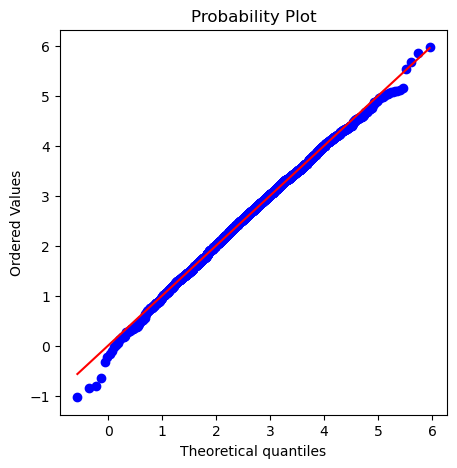

In [35]:
test_risduals(diff, distribution=stats.norm, cdf='norm')

/Users/mac/opt/anaconda3/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but Lasso was fitted without feature names
  warnings.warn(
/Users/mac/opt/anaconda3/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but Lasso was fitted without feature names
  warnings.warn(
/Users/mac/opt/anaconda3/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but Lasso was fitted without feature names
  warnings.warn(
/Users/mac/opt/anaconda3/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but Lasso was fitted without feature names
  warnings.warn(
/Users/mac/opt/anaconda3/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but Lasso was fitted without feature names
  warnings.warn(
/Users/mac/opt/anaconda3/lib/python3.9/site-packages/sklearn/base.py:443: UserWarning: X has feature names, but Lasso was fitted without feature names
  warning

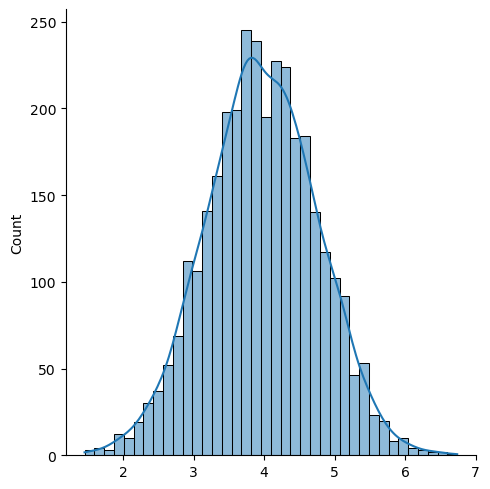

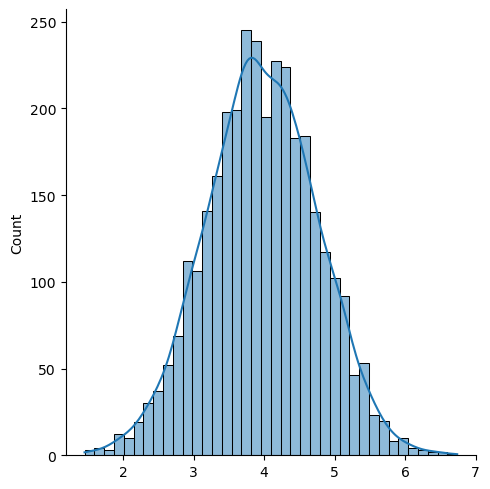

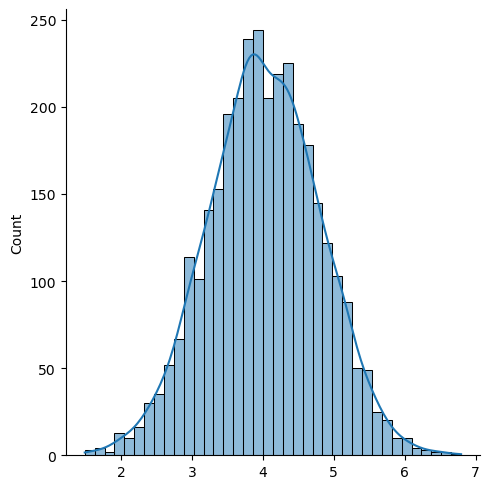

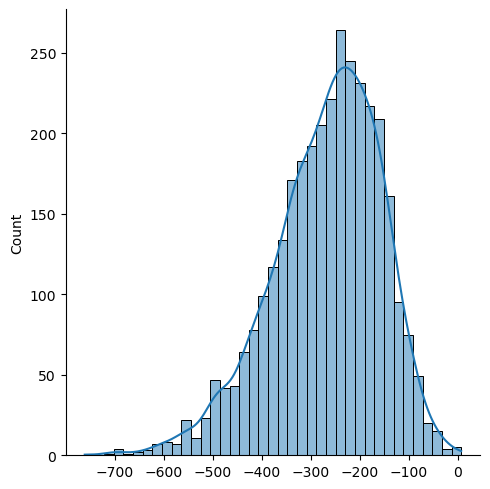

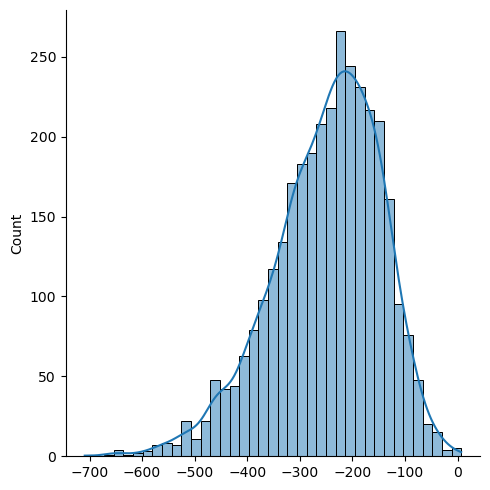

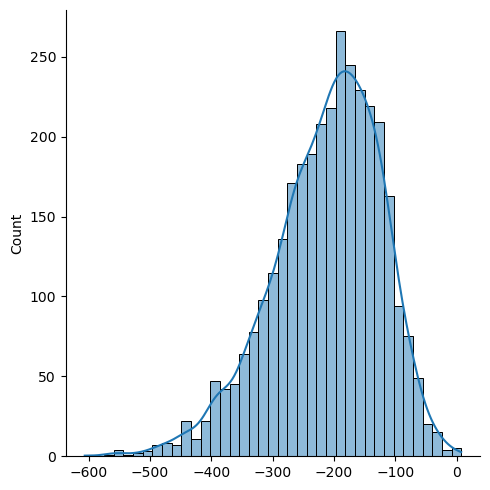

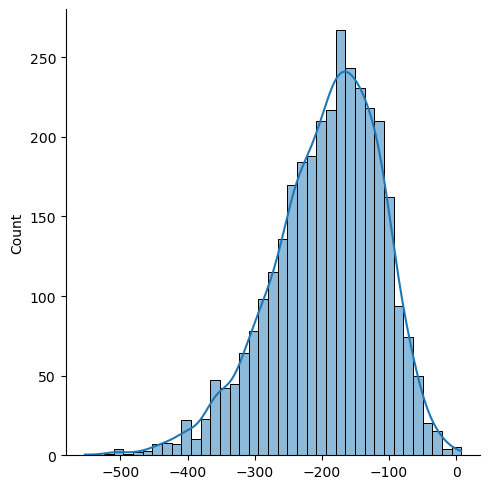

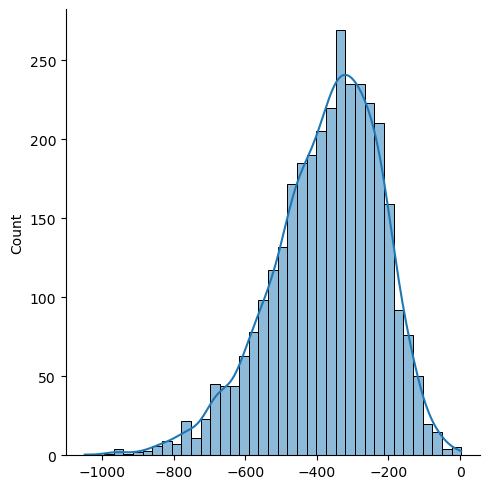

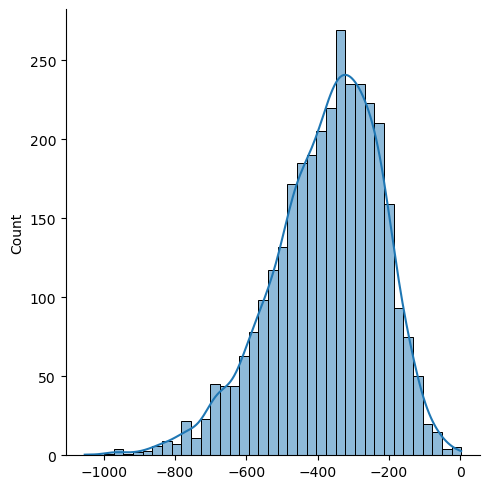

In [36]:

for i in range(len(lassos_all)):

    y_pred_lasso = lassos_all[i].predict(dataPredOrg)
    # distribution of residuals
    target = np.array(dataTargetOrg)
    predicts_lasso = np.array(y_pred_lasso)
    diff_lasso = target[:,0] - predicts_lasso   
    sns.displot(diff_lasso, kde=True)

Mean: -374.4881629198698
Shapiro-Wilk Test: 2.961518133880183e-22
Kolmogorov-Smirnov Test: 2.0729139307104465e-08


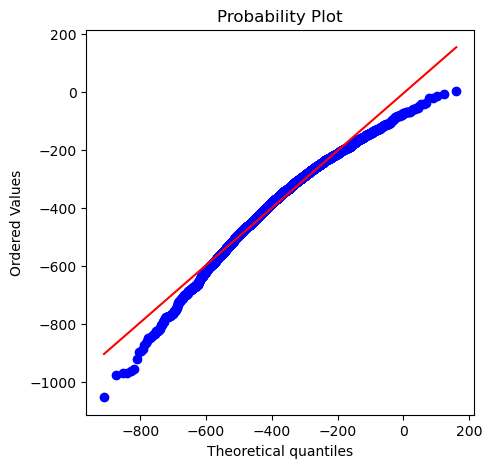

In [37]:
test_risduals(diff_lasso, distribution=stats.norm, cdf='norm')

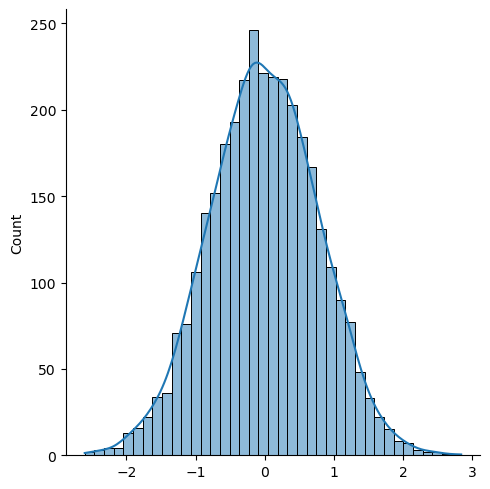

In [38]:
## Linear Regression
y_pred_linear = lr.predict(dataPredOrg)
# distribution of residuals
predicts_linear = np.array(y_pred_linear)
diff_linear = target[:,0] - predicts_linear[:,0]
sns.displot(diff_linear,kde = True)

Mean: -0.007737813175639548
Shapiro-Wilk Test: 0.9890507459640503
Kolmogorov-Smirnov Test: 0.9605972063125462


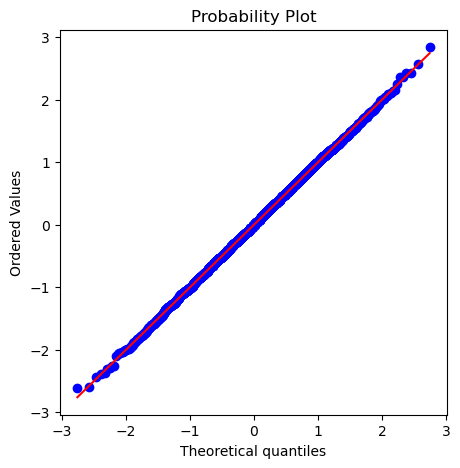

In [39]:
test_risduals(diff_linear, distribution=stats.norm, cdf='norm')